In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import Dense,Flatten,Conv2D,MaxPooling2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers  import Concatenate
from tensorflow.keras.layers import AveragePooling2D, Dropout, Input, BatchNormalization
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix
from PIL import Image
from tqdm import tqdm
import urllib
from tensorflow.keras.preprocessing import image
from sklearn.metrics import precision_recall_curve,roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
import os
from sklearn.metrics import log_loss, brier_score_loss
from sklearn.metrics import cohen_kappa_score
import matplotlib.cm as cm
from sklearn.metrics import matthews_corrcoef
import pandas as pd
import seaborn as sns
import numpy as np
import cv2
from sklearn.preprocessing import label_binarize
from sklearn.metrics import average_precision_score
from tensorflow.keras.utils import to_categorical
%matplotlib inline

In [ ]:
!pip install kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"hollyagustine","key":"66ab1671b11c8682cdb26fe1194c8b81"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d vipoooool/new-plant-diseases-dataset

Dataset URL: https://www.kaggle.com/datasets/vipoooool/new-plant-diseases-dataset
License(s): copyright-authors
 99% 2.68G/2.70G [00:23<00:00, 115MB/s]
100% 2.70G/2.70G [00:23<00:00, 125MB/s]


In [ ]:
!unzip new-plant-diseases-dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/273a7a9e-18be-4b6a-976a-fa5ffd69b731___RS_HL 4366_90deg.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/275f8963-f4f4-4903-962b-1da716725d08___RS_HL 4780_90deg.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/275f8963-f4f4-4903-962b-1da716725d08___RS_HL 4780_new30degFlipLR.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/27c2aaa4-de4b-4fb1-ba8d-14d4b24b2afa___RS_HL 4665.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/27c2aaa4-de4b-4fb1-ba8d-14d4b24b2afa___RS_HL 4665_270deg.JPG  
  inflating: new plant diseases dataset(augmented)/New 

In [ ]:
image_path = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train"
train_image_path = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train"
valid_image_path = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid"
test_image_path = "/content/test/test"

In [ ]:
class_names = os.listdir(image_path)
class_names

['Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Tomato___Early_blight',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Peach___Bacterial_spot',
 'Pepper,_bell___healthy',
 'Corn_(maize)___Common_rust_',
 'Blueberry___healthy',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Potato___Early_blight',
 'Apple___Apple_scab',
 'Soybean___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Corn_(maize)___healthy',
 'Tomato___Target_Spot',
 'Tomato___Bacterial_spot',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Apple___Cedar_apple_rust',
 'Grape___Esca_(Black_Measles)',
 'Tomato___Tomato_mosaic_virus',
 'Apple___healthy',
 'Potato___Late_blight',
 'Squash___Powdery_mildew',
 'Grape___Black_rot',
 'Pepper,_bell___Bacterial_spot',
 'Strawberry___Leaf_scorch',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Cherry_(including_sour)___Powdery_mildew',
 'Tomato___healthy',
 'Potato___healthy',
 'Grape___healthy',
 'Cherry_(including_sour)___healthy',
 'Tomato___Septoria_leaf_spot'

In [ ]:
numberof_images={}
for class_name in class_names:
    numberof_images[class_name]=len(os.listdir(image_path+"/"+class_name))
images_each_class=pd.DataFrame(numberof_images.values(),index=numberof_images.keys(),columns=["Number of images"])
images_each_class

,Number of images
Grape___Leaf_blight_(Isariopsis_Leaf_Spot),1722
Tomato___Early_blight,1920
Tomato___Spider_mites Two-spotted_spider_mite,1741
Peach___Bacterial_spot,1838
"Pepper,_bell___healthy",1988
Corn_(maize)___Common_rust_,1907
Blueberry___healthy,1816
Tomato___Late_blight,1851
Tomato___Leaf_Mold,1882
Potato___Early_blight,1939


In [ ]:
def create_data_frame(path):
    list_plant=[]
    list_category=[]
    list_disease=[]
    list_path=[]
    list_plant_category=[]
    list_image_size=[]
    list_image_type=[]
    list_size=[]

    for path,directory,files in os.walk(path,topdown=False):
        for name in files:
            plant_category=category=path.split("/")[-1]
            plant=plant_category.split("___")[0]
            category=plant_category.split("___")[-1]
            disease=0 if category=="healthy" else 1
            full_path=path+"/"+name
            image_type=name.split(".")[1]
            size=os.path.getsize(full_path)
            with Image.open(full_path) as images:
                width,height=images.size
            list_plant.append(plant)
            list_category.append(category)
            list_disease.append(disease)
            list_path.append(full_path)
            list_plant_category.append(plant_category)
            list_image_size.append(str(width)+"x"+str(height))
            list_image_type.append(image_type)
            list_size.append(size)

    data_info = pd.DataFrame.from_dict({"Plant":list_plant,"Category":list_category,"Disease":list_disease,
                           "Path":list_path,"Plant_Category":list_plant_category,"Image_size":list_image_size,
                                        "Image_type":list_image_type,"Size":list_size},orient="columns")

    image_count_info = pd.DataFrame(data_info.groupby(["Plant","Category","Plant_Category"]).size())
    image_count_info.rename(columns={0:"nb"},inplace=True)
    image_count_info = image_count_info.reset_index()
    return data_info,image_count_info

train_data_info,train_data_count=create_data_frame(train_image_path)
valid_data_info,valid_data_count=create_data_frame(valid_image_path)

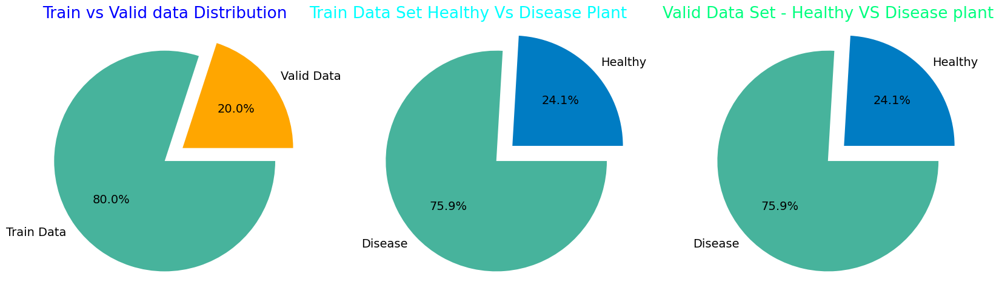

In [ ]:
def image_information(data_set_info):
    plt.rcParams["font.size"]=14
    plt.pie([data_set_info.nb[data_set_info.Category=="healthy"].sum(),data_set_info.nb[data_set_info.Category!="health"].
                                                                 sum()],labels=["Healthy","Disease"],autopct=lambda x:str(round(x,1))+"%",
                                                                 colors=["#007CC3","#47B39C"],shadow=False,explode=(0.20,0))


plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plt.title("Train vs Valid data Distribution",fontsize=19,color="Blue")
plt.rcParams["font.size"]=14

# image_information(valid_data_count)
plt.pie([valid_data_count.nb.sum(),train_data_count.nb.sum()],labels=["Valid Data","Train Data"],
                                                              autopct=lambda x: str(round(x,2))+"%",
                                                              colors=["#FFA600","#47B39C"],shadow=False,explode=(0.20,0))

plt.subplot(1,3,2)
plt.title("Train Data Set Healthy Vs Disease Plant "        "          "  ,fontsize=19,color="aqua")
image_information(train_data_count)

plt.subplot(1,3,3)
plt.title('Valid Data Set - Healthy VS Disease plant', fontsize=19,color="springgreen")
image_information(valid_data_count)

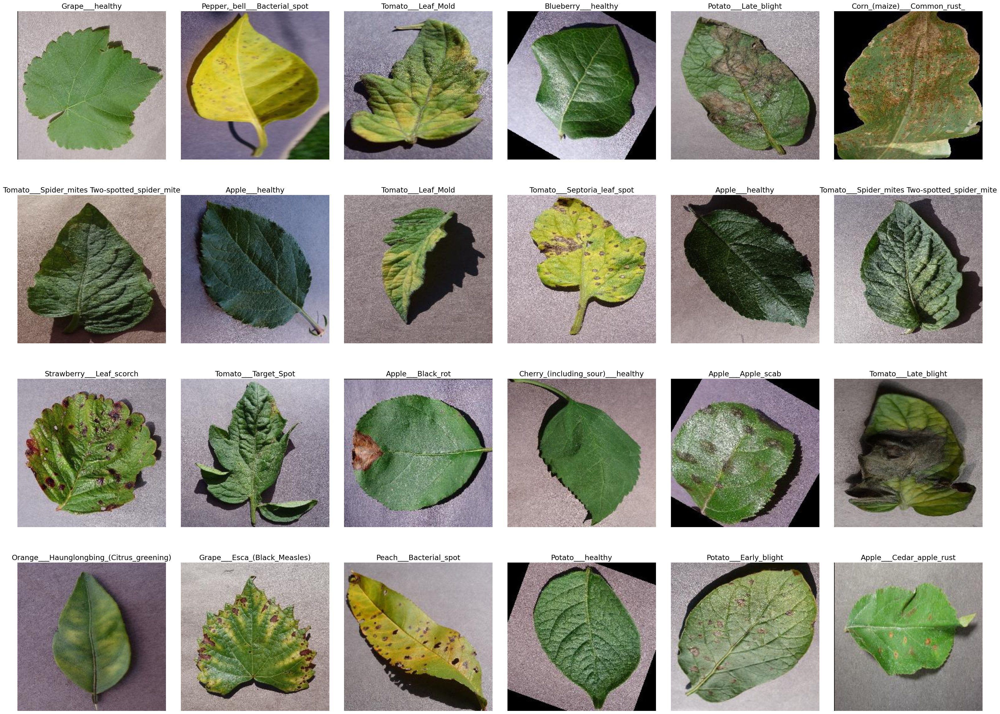

In [ ]:
plt.figure(figsize=(40,30))
plt.subplots_adjust(wspace=0.1, hspace=0.1)

for i in range(24):
    random_folder = np.random.randint(0, len(os.listdir(image_path)))
    random_folder_path = os.path.join(image_path, os.listdir(image_path)[random_folder])
    random_image = np.random.randint(0, len(os.listdir(random_folder_path)))
    random_image_path = os.path.join(random_folder_path, os.listdir(random_folder_path)[random_image])
    image = cv2.imread(random_image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get the class name for the current image
    class_name = class_names[random_folder]

    plt.subplot(4, 6, i + 1)
    plt.imshow(image)
    plt.axis("off")
    plt.title(class_name)

plt.show()

In [ ]:
traindata_generator=tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255,zoom_range=0.2,width_shift_range=0.2,height_shift_range=0.2,
                                                                    shear_range=0.2, horizontal_flip=True,validation_split=0.2)

validdata_generator=tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

testdata_generator=tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

batch_size = 32

train_data_generator=traindata_generator.flow_from_directory(train_image_path,batch_size=batch_size,class_mode="categorical",
                                                           target_size=(120,120),color_mode="rgb",shuffle=True)

valid_data_generator=validdata_generator.flow_from_directory(valid_image_path,batch_size=batch_size,class_mode="categorical",
                                                           target_size=(120,120),color_mode="rgb",shuffle=True)

test_data_generator=testdata_generator.flow_from_directory(valid_image_path,batch_size=batch_size,class_mode="categorical",
                                                           target_size=(120,120),color_mode="rgb",shuffle=False)

Found 70295 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.


In [ ]:
train_number=train_data_generator.samples
valid_number=valid_data_generator.samples
print("Training number samples: ", train_number)
print("Validation number samples: ", valid_number)

Training number samples:  70295
Validation number samples:  17572


In [ ]:
# creating GoogleNet model
def inceptionnet(x,filters):

    #(1x1) layer
    layer1=Conv2D(filters=filters[0],kernel_size=(1,1),strides=1,padding="same",activation="relu")(x)

    #(3x3) layer
    layer2=Conv2D(filters=filters[1][0],kernel_size=(1,1),strides=1,padding="same",activation="relu")(x)


    layer2=Conv2D(filters=filters[1][1],kernel_size=(1,1),strides=1,padding="same",activation="relu")(layer2)

    #(5x5) layer

    layer3=Conv2D(filters=filters[2][0],kernel_size=(5,5),strides=1,padding="same",activation="relu")(x)

    layers=Conv2D(filters=filters[2][1],kernel_size=(5,5),strides=1,padding="same",activation="relu")(layer3)



    layer4=MaxPooling2D(pool_size=(3,3),strides=1,padding="same")(x)
    layer4=Conv2D(filters=filters[3],kernel_size=(1,1),strides=1,padding="same",activation="relu")(layer4)


    return Concatenate(axis=-1)([layer1,layer2,layer3,layer4])


def helperfunction(x,name=None):

    layer=AveragePooling2D(pool_size=(5,5),strides=3,padding="valid")(x)

    layer=Conv2D(filters=128,kernel_size=(1,1),strides=1,padding="same",activation="relu")(layer)

    layer=Flatten()(layer)

    layer=Dense(units=255,activation="relu")(layer)

    layer=Dropout(0.4)(layer)
    layer=Dense(units=38,activation="softmax",name=name)(layer)

    return layer


def googlenet():

    #taking layer input
    inputlayer=Input(shape=(120,120,3))

    #layer_1
    layer=Conv2D(filters=64,kernel_size=(7,7),strides=1,padding="same",activation="relu")(inputlayer)

    layer=MaxPooling2D(pool_size=(3,3),strides=2,padding="same")(layer)

    layer=BatchNormalization()(layer)

    #layer_2
    layer=Conv2D(filters=64,kernel_size=(1,1),strides=1,padding="same",activation="relu")(layer)

    layer=Conv2D(filters=192,kernel_size=(3,3),strides=1,padding="same",activation="relu")(layer)

    layer=BatchNormalization()(layer)
    layer=MaxPooling2D(pool_size=(3,3),strides=2,padding="same")(layer)

    #layer_3
    layer=inceptionnet(layer,[64,(96,128),(16,32),32])
    layer=inceptionnet(layer,[128,(128,192),(32,96),64])
    layer=MaxPooling2D(pool_size=(3,3),strides=2,padding="same")(layer)

    #layer_4
    layer=inceptionnet(layer,[192,(96,208),(16,48),64])
    final_0=helperfunction(layer,name="final_layer_0")

    layer=inceptionnet(layer,[160,(112,224),(24,64),64])
    layer=inceptionnet(layer,[128,(128,256),(24,64),64])
    layer=inceptionnet(layer,[112,(144,288),(32,64),64])
    final_1=helperfunction(layer,name="final_layer_1")

    layer=inceptionnet(layer,[256,(160,320),(32,128),128])
    layer=MaxPooling2D(pool_size=(3,3),strides=2,padding="same")(layer)

    #layer_5
    layer=inceptionnet(layer,[256,(160,320),(32,128),128])
    layer=inceptionnet(layer,[384,(192,384),(48,128),128])
    layer=AveragePooling2D(pool_size=(7,7),strides=1,padding="same")(layer)

    #layer_6

    layer=Flatten()(layer)
    layer=Dropout(0.4)(layer)
    layer=Dense(units=256,activation="linear")(layer)
    final_2=Dense(units=38,activation="softmax",name="final_layer_2")(layer)


    model=Model(inputs=inputlayer,outputs=[final_2,final_0,final_1])

    return model

In [ ]:
model = googlenet()
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 120, 120, 64)         9472      ['input_1[0][0]']             
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 60, 60, 64)           0         ['conv2d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 60, 60, 64)           256       ['max_pooling2d[0][0]']   

In [ ]:
learning_rate = 0.001

opti = Adam(learning_rate=learning_rate)

model.compile(loss=['categorical_crossentropy', 'categorical_crossentropy', 'categorical_crossentropy'],
              loss_weights=[1, 0.3, 0.3], optimizer=opti, metrics=['accuracy'])

In [ ]:
history = model.fit(train_data_generator,
                    validation_data=valid_data_generator,
                    steps_per_epoch=train_number // batch_size,
                    epochs=20,
                    validation_steps=valid_number // batch_size,
                    verbose=1)

Epoch 1/20
2196/2196 [==============================] - 487s 206ms/step - loss: 2.4806 - final_layer_2_loss: 1.5389 - final_layer_0_loss: 1.5220 - final_layer_1_loss: 1.6170 - final_layer_2_accuracy: 0.5435 - final_layer_0_accuracy: 0.5459 - final_layer_1_accuracy: 0.5142 - val_loss: 3.8343 - val_final_layer_2_loss: 2.3860 - val_final_layer_0_loss: 2.6660 - val_final_layer_1_loss: 2.1619 - val_final_layer_2_accuracy: 0.4310 - val_final_layer_0_accuracy: 0.4435 - val_final_layer_1_accuracy: 0.4760
Epoch 2/20
2196/2196 [==============================] - 459s 209ms/step - loss: 0.8705 - final_layer_2_loss: 0.5234 - final_layer_0_loss: 0.5678 - final_layer_1_loss: 0.5893 - final_layer_2_accuracy: 0.8364 - final_layer_0_accuracy: 0.8244 - final_layer_1_accuracy: 0.8184 - val_loss: 1.1866 - val_final_layer_2_loss: 0.7441 - val_final_layer_0_loss: 0.7693 - val_final_layer_1_loss: 0.7056 - val_final_layer_2_accuracy: 0.7771 - val_final_layer_0_accuracy: 0.7892 - val_final_layer_1_accuracy: 0.7

In [ ]:
# Saving the model
model.save("model.h5")
from tensorflow.keras.models import load_model

model = load_model("model.h5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
#Model Prediction
pred, _, _=model.predict(test_data_generator)
final_predict = np.argmax(pred,axis=1)
true_data=test_data_generator.classes

550/550 [==============================] - 31s 56ms/step


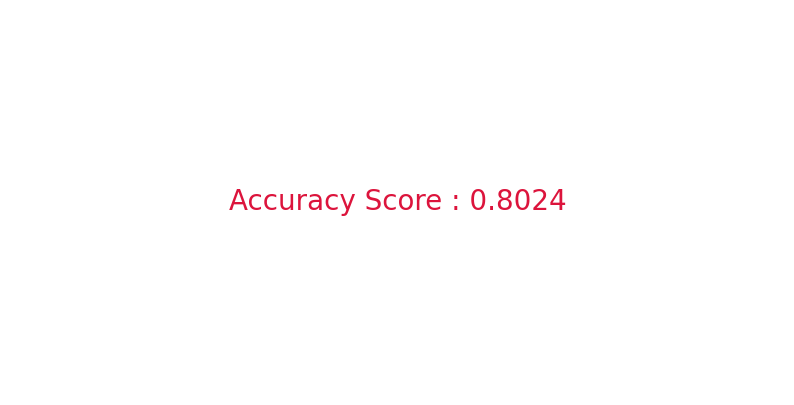

In [ ]:
#Accuracy Score
plt.figure(figsize=(10,5),facecolor="white")
acc_score = accuracy_score(true_data,final_predict)
plt.plot([])
plt.text(0,0, f'Accuracy Score : {acc_score:.4f}', fontsize=20, ha='center', va='center',color="crimson")
plt.axis('off')

# Set the x-axis limits
plt.xlim(-1, 1)
plt.ylim(-1,1)

plt.show()

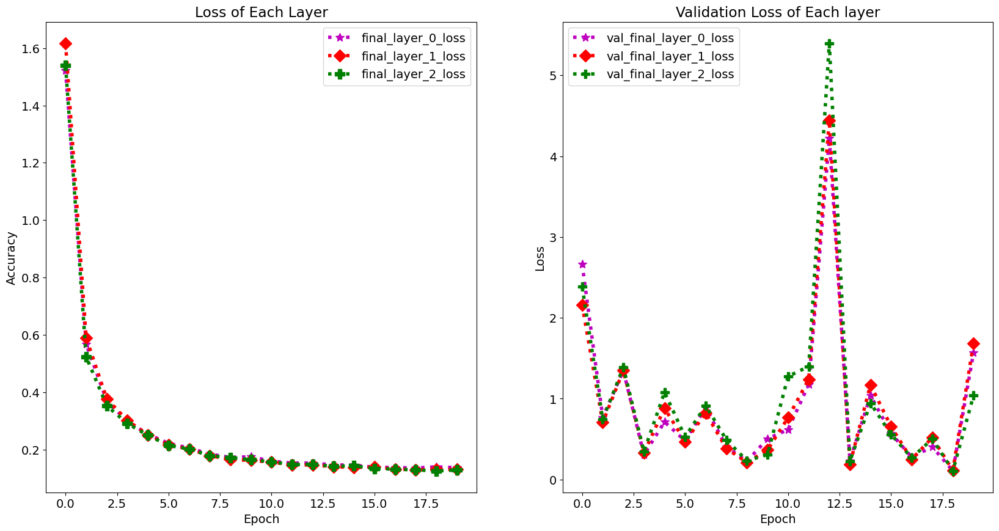

In [ ]:
#Loss and Validation loss Graph
def plot_history_loss_validation_loss(history):

    # Plot the accuracy of each layer
    plt.figure(figsize=(20,10))
    plt.subplot(121)
    plt.plot(history.history['final_layer_0_loss'], label='final_layer_0_loss',
             marker="*",linestyle=":",color="m", linewidth=4,markersize=10)
    plt.plot(history.history['final_layer_1_loss'], label='final_layer_1_loss',
             marker="D",linestyle=":",color="r", linewidth=4,markersize=10)
    plt.plot(history.history['final_layer_2_loss'], label='final_layer_2_loss',
             marker="P",linestyle=":",color="g", linewidth=4,markersize=12)

    plt.title('Loss of Each Layer')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')

    plt.legend()

    # Plot the loss of each layer
    plt.subplot(122)
    plt.plot(history.history['val_final_layer_0_loss'], label='val_final_layer_0_loss',
             marker="*",linestyle=":",color="m", linewidth=4,markersize=10)
    plt.plot(history.history['val_final_layer_1_loss'], label='val_final_layer_1_loss',
             marker="D",linestyle=":",color="r", linewidth=4,markersize=10)
    plt.plot(history.history['val_final_layer_2_loss'], label='val_final_layer_2_loss',
             marker="P",linestyle=":",color="g", linewidth=4,markersize=10)

    plt.title('Validation Loss of Each layer')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')

    plt.legend()
    plt.show()

plot_history_loss_validation_loss(history)

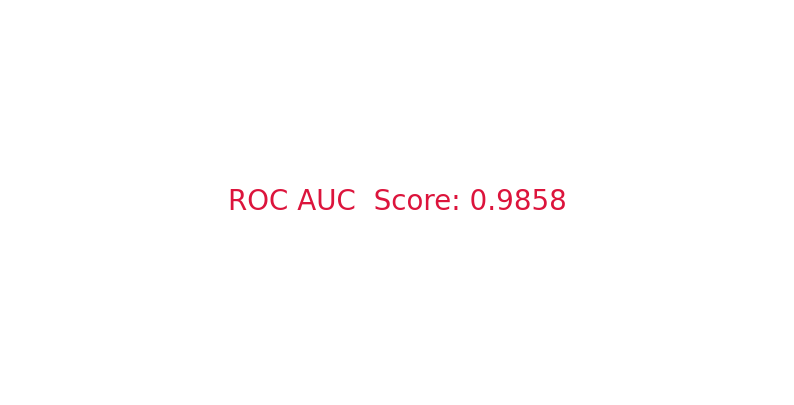

In [ ]:
#ROC (Receiver Operating Characteristics) Accuracy Score
#AUC (Area Under ROC Curve)

plt.figure(figsize=(10,5),facecolor='white')
roc_auc = roc_auc_score(true_data, pred,multi_class='ovr')
plt.plot([])
plt.text(0,0, f'ROC AUC  Score: {roc_auc:.4f}', fontsize=20, ha='center', va='center',color="crimson")
plt.axis('off')

# Set the x-axis limits
plt.xlim(-1, 1)
plt.ylim(-1,1)

plt.show()

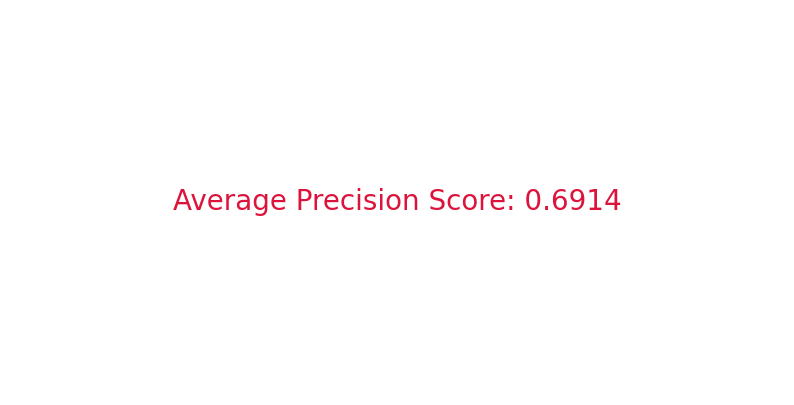

In [ ]:
#Average Precision Score
plt.figure(figsize=(10,5),facecolor="white")

# Convert true labels to multilabel-indicator format
num_classes = 38  # Number of classes
true_data_multilabel = label_binarize(true_data, classes=np.arange(num_classes))

# Reshape predicted labels to match the shape of the true labels
final_predict_reshaped = label_binarize(final_predict, classes=np.arange(num_classes))
average_precision = average_precision_score(true_data_multilabel, final_predict_reshaped)

plt.plot([])
plt.text(0,0, f'Average Precision Score: {average_precision:.4f}', fontsize=20, ha='center', va='center',color="crimson")
plt.axis('off')
plt.xlim(-1, 1)
plt.ylim(-1,1)

plt.show()

In [ ]:
#Classification Report
print(classification_report(true_data, final_predict,target_names=class_names))

                                                    precision    recall  f1-score   support

        Grape___Leaf_blight_(Isariopsis_Leaf_Spot)       0.99      0.84      0.91       504
                             Tomato___Early_blight       0.98      0.89      0.93       497
     Tomato___Spider_mites Two-spotted_spider_mite       0.99      0.88      0.93       440
                            Peach___Bacterial_spot       0.61      0.80      0.70       502
                            Pepper,_bell___healthy       0.94      0.55      0.69       454
                       Corn_(maize)___Common_rust_       0.91      0.92      0.91       421
                               Blueberry___healthy       0.97      0.75      0.85       456
                              Tomato___Late_blight       0.65      0.99      0.78       410
                                Tomato___Leaf_Mold       0.99      0.99      0.99       477
                             Potato___Early_blight       0.99      0.63      0.

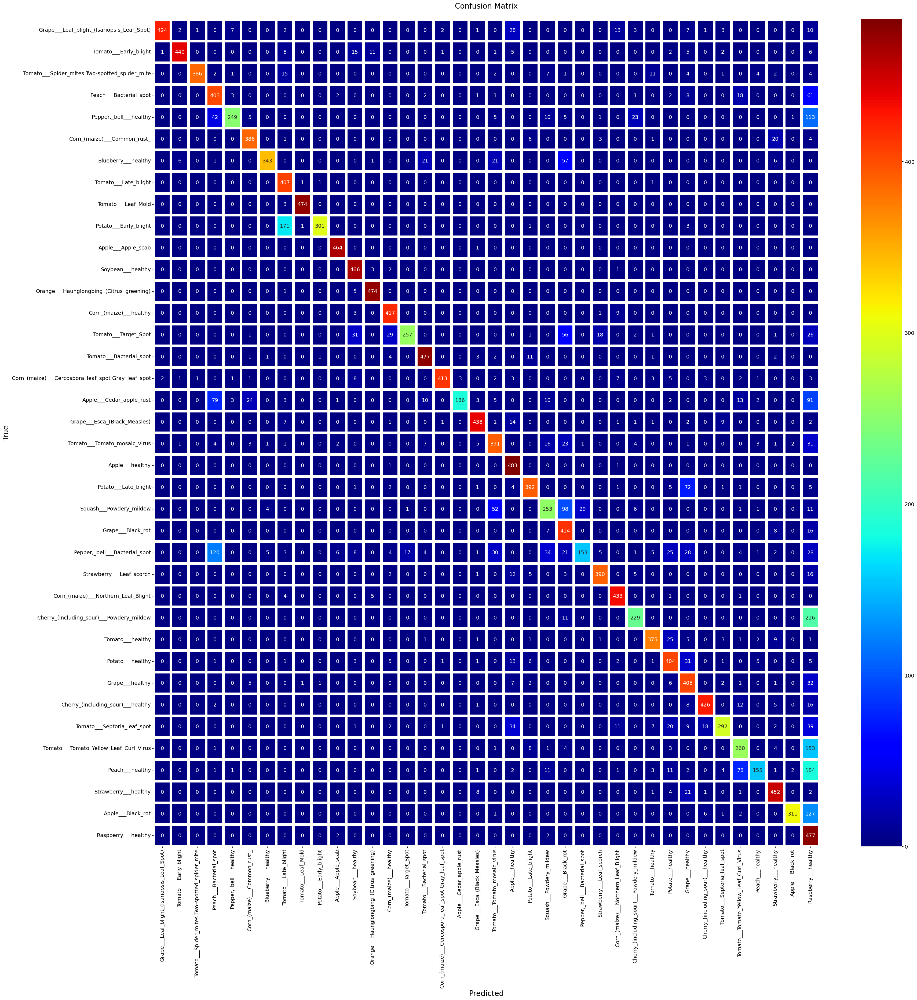

In [ ]:
#Confusion Matrix
plt.figure(figsize=(40,40))
confusion = confusion_matrix(true_data, final_predict)
sns.heatmap(confusion, annot=True, fmt='d', cmap='jet',xticklabels=class_names,
            yticklabels=class_names,lw=6)
plt.xlabel('Predicted',fontsize=20,color="black")
plt.ylabel('True',fontsize=20,color="black")
plt.title('Confusion Matrix\n',fontsize=20,color="black")
plt.show()

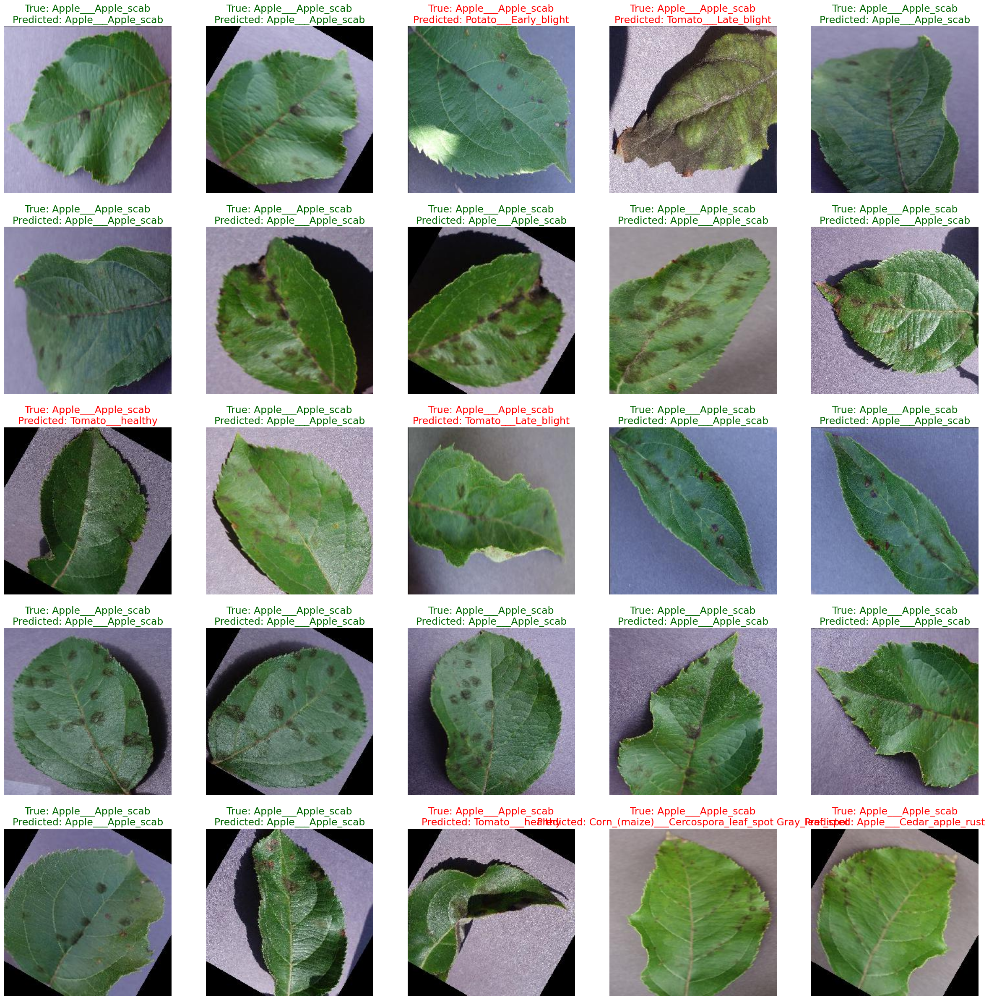

In [ ]:
#Checking Model Prediction
class_name = list(test_data_generator.class_indices.keys())

plt.figure(figsize=(30,30))
number_images=(5,5)
for i in range(1,(number_images[0]*number_images[1])+1):
    plt.subplot(number_images[0],number_images[1],i)
    plt.axis("off")

    true_label = class_name[test_data_generator.classes[i]]
    predicted_label = class_name[final_predict[i]]

    color="darkgreen"
    if true_label != predicted_label:
        color="red"

    plt.title(f"True: {true_label}\nPredicted: {predicted_label}", color=color)
    plt.imshow(plt.imread(test_data_generator.filepaths[i]))
plt.show()